## Install Libraries (For Google Colab)

In [4]:
!pip install powerlaw

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.0/192.0 kB 14.1 MB/s eta 0:00:00


In [5]:
!pip install py3Dmol

In [6]:
!pip install Infomap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 264.8/264.8 kB 19.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for Infomap: filename=infomap-2.8.0-cp312-cp312-linux_x86_64.whl size=7716614 sha256=8d0dc5183df9eba8908b9f8f309d290ee40e93436973698a88af37975f1b341e
  Stored in directory: /root/.cache/pip/wheels/0a/d5/d5/dab47e5b039fb1997c5ca2835ee7c9a7c7e1bf2615191aebb1
Successfully built Infomap


In [7]:
!pip install Bio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 321.3/321.3 kB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 59.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 2.5 MB/s eta 0:00:00


In [8]:
!pip install biopython propka

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 7.6 MB/s eta 0:00:00


## Local Libraries

In [14]:
import sys
sys.path.append('../modules')

from network_generation import *
from network_analisis import *
from structural_analisis import *

## Configuration

In [15]:
# Configuración de estilo para las visualizaciones
plt.style.use('seaborn-v0_8-darkgrid')
matplotlib.rcParams['figure.figsize'] = [12, 8]
matplotlib.rcParams['font.size'] = 12

## Application

## ICL2 bound Acetyl-Coa form analysis I [(6EDZ)](https://www.rcsb.org/structure/6EDZ)

 #### a) Uploading and network generation

In [16]:
# Upload data GPCR-Drug complex
json_path = "../graphs/6EDZ-R-Network.json"
data02 = load_ring_json_data(json_path)

File loaded successfully
Main keys: ['data', 'directed', 'multigraph', 'elements']
Directed graph: False
Multigraph: True


In [17]:
# Extract nodes and edges
nodes_S02, edges_S02 = extract_nodes_edges(data02)
# Create DataFrames
df_nodes_S02 = pd.DataFrame(nodes_S02)
df_edges_S02 = pd.DataFrame(edges_S02)

Number of nodes extracted: 2923
Number of edges (interactions) extracted: 5587


In [18]:
df_nodes_S02

,id,name,residue,chain,resi,resn,degree,dssp,x_coord,y_coord,z_coord
0,A/100/ILE,A/100/ILE,A/100/ILE,A,100,ILE,3,,0.212,0.578,0.384
1,A/101/GLU,A/101/GLU,A/101/GLU,A,101,GLU,8,,0.213,0.588,0.412
2,A/102/ALA,A/102/ALA,A/102/ALA,A,102,ALA,2,,0.230,0.562,0.424
3,A/103/ILE,A/103/ILE,A/103/ILE,A,103,ILE,4,E,0.251,0.537,0.418
4,A/104/TYR,A/104/TYR,A/104/TYR,A,104,TYR,4,E,0.256,0.503,0.424
...,...,...,...,...,...,...,...,...,...,...,...
2918,D/95/MET,D/95/MET,D/95/MET,D,95,MET,6,H,0.620,0.404,0.556
2919,D/96/LYS,D/96/LYS,D/96/LYS,D,96,LYS,7,H,0.630,0.388,0.532
2920,D/97/ARG,D/97/ARG,D/97/ARG,D,97,ARG,4,H,0.657,0.407,0.535
2921,D/98/MET,D/98/MET,D/98/MET,D,98,MET,4,H,0.658,0.396,0.563


In [19]:
df_edges_S02

,source,target,interaction,type,distance,probability,energy
0,A/100/ILE,A/95/MET,HBOND,,2.958,1.0,0
1,A/100/ILE,A/95/MET,VDW,,2.737,1.0,0
2,A/100/ILE,A/96/LYS,VDW,,2.709,1.0,0
3,A/101/GLU,A/173/PHE,VDW,,2.721,1.0,0
4,A/101/GLU,A/70/ARG,HBOND,,2.720,1.0,0
...,...,...,...,...,...,...,...
5582,D/93/VAL,D/97/ARG,VDW,,2.760,1.0,0
5583,D/94/SER,D/98/MET,HBOND,,2.992,1.0,0
5584,D/95/MET,D/99/GLY,HBOND,,3.103,1.0,0
5585,D/96/LYS,D/99/GLY,HBOND,,3.073,1.0,0


In [ ]:
# Save DataFrames
df_nodes_S02.to_csv('6EDZ-protein_nodes.csv', index=False)
df_edges_S02.to_csv('6EDZ-protein_interactions.csv', index=False)

In [ ]:
# Create Network
G_S02 = create_graph_from_dataframes(df_nodes_S02, df_edges_S02)

**Basic descriptors**

In [ ]:
print("\n=== GRAPH INFORMATION ===")
print(f"Number of nodes: {G_S02.number_of_nodes()}")
print(f"Number of edges: {G_S02.number_of_edges()}")
print(f"Graph density: {nx.density(G_S02):.4f}")
print(f"Is the graph connected? {nx.is_connected(G_S02)}")

# Additional information about nodes
if G_S02.number_of_nodes() > 0:
    first_node = list(G_S02.nodes(data=True))[0]
    print(f"\nNode example: {first_node[0]}")
    print(f"Node attributes: {first_node[1]}")


=== GRAPH INFORMATION ===
Number of nodes: 2923
Number of edges: 3940
Graph density: 0.0009
Is the graph connected? False

Node example: A/100/ILE
Node attributes: {'residue': 'A/100/ILE', 'chain': 'A', 'resi': 100, 'resn': 'ILE', 'degree': 3, 'dssp': ' ', 'x_coord': 0.212, 'y_coord': 0.578, 'z_coord': 0.384}


### Analisis

#### **a) Clustering: average clustering coefficient.**

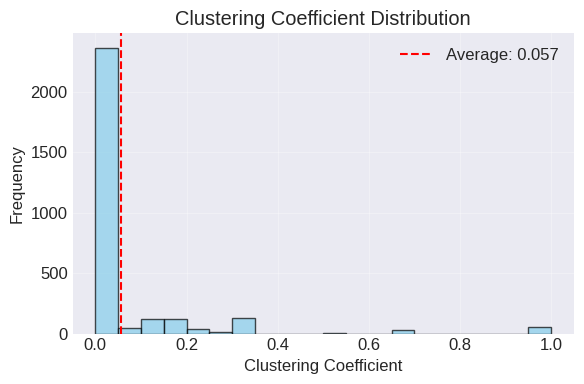

Average Clustering Coefficient: 0.0572
Number of nodes: 2923
Number of edges: 3940


In [ ]:
df_Clustering_coefficient_G_S02=analyze_clustering(G_S02)

#### **b) Distances: average shortest–path length and (effective) diameter.**

Graph not connected. Using giant component...
Nodes in giant component: 2645
Calculating distances... (may take time for large graphs)


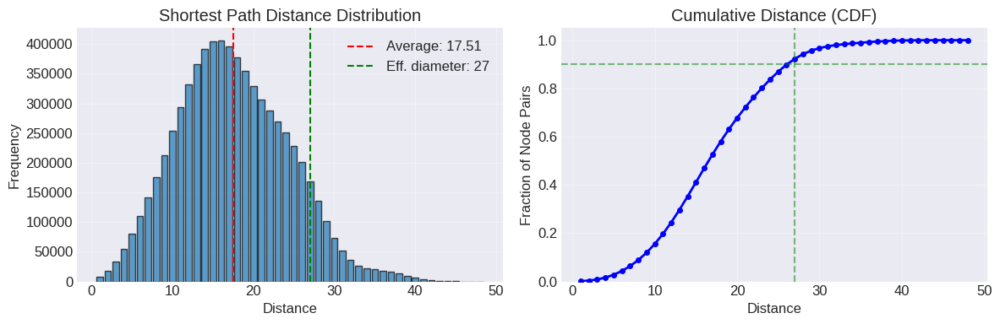


=== DISTANCE RESULTS ===
Average path length: 17.5109
Diameter (maximum distance): 48
Effective diameter (90%): 27
Number of node pairs: 6993380
Most common distance: 16 (appears 406632 times)


In [ ]:
dict_Distances_G_S02=analyze_distances(G_S02)

#### **c) Degree statistics:**

**Degree distribution**

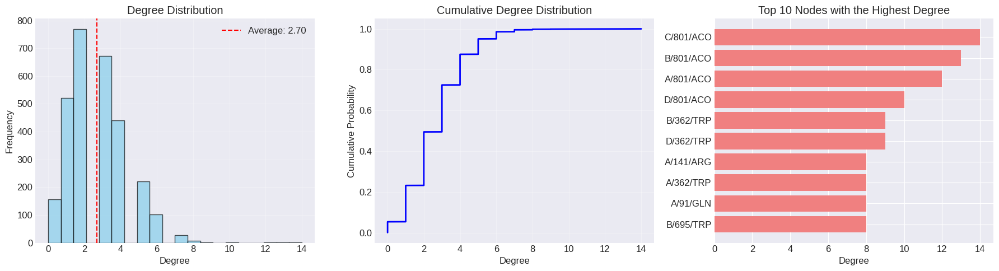


=== DEGREE STATISTICS===
Average degree: 2.70
Highest degree: 14
Minimum degree: 0
Standard deviation: 1.58

Top 10 residues with a higher average grade:
  ACO: 12.25
  TRP: 6.05
  PHE: 4.20
  TYR: 3.60
  ARG: 3.48
  MET: 3.46
  ASN: 3.25
  HIS: 2.94
  ILE: 2.89
  GLN: 2.76


In [ ]:
# Generar gráficos de distribución de grado
degrees_S02 = plot_distribucion_grado(G_S02)

**Degree statistics: Network topology analysis**

/usr/local/lib/python3.12/dist-packages/powerlaw/fitting.py:264: UserWarning: Values less than or equal to 0 in data. Throwing out 0 or negative values.
  warnings.warn("Values less than or equal to 0 in data. Throwing out 0 or negative values.")


Calculating best minimal value for power law fit


Fitting xmin: 100%|██████████| 11/11 [00:00<00:00, 225.28it/s]
/usr/local/lib/python3.12/dist-packages/powerlaw/distributions.py:743: OptimizeWarning: Initial guess is not within the specified bounds
  result = scipy.optimize.minimize(fit_function,


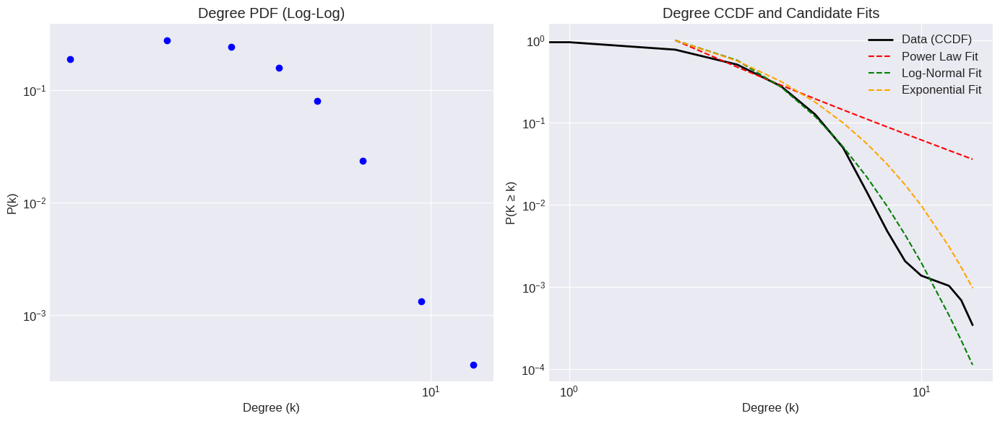

Estimated Alpha value (Power Law): 2.55
xmin value (tail start): 2.0

Power Law vs Exponential comparison: R=-343.64, p-value=0.0000
Power Law vs Log-Normal comparison: R=-440.21, p-value=0.0000


In [ ]:
analyze_degree_statistics(G_S02)

**Discussion**

- **$α=2.61$:** This value falls within the typical range for "small-world" networks (usually between 2<α<3) but the likelihood ratio tests indicate otherwise. Then, this number is only an estimate of the slope in a specific segment, but does not define the overall nature of the network.
- **Negative R (R<0):** In both the comparison with the Exponential (R=−342.53) and Log-Normal (R=−458.48) models, the negative sign indicates that the second model is much better than Power Law at explaining the data.
- **Statistical Significance (p=0.0000):** Because it is less than 0.05, with complete certainty these results are not due to chance.

After performing a goodness-of-fit analysis using the Likelihood Ratio Test, the hypothesis of a Power Law distribution was rejected (p<0.05). The data show a statistically significant preference for a Log-Normal distribution (R=−458.48), suggesting that the network does not have a scale-free architecture, but rather exhibits saturation in the connectivity of the most important nodes. In terms of protein physics, the coexistence of a Log-Normal degree distribution with Small-world properties reveals how evolution has optimized the protein structure to be efficient:
- **Log-Normal distribution**:  The fact that the likelihood ratio (R) test favors the Log-Normal distribution over the Power Law distribution is due to spatial and volume exclusion constraints (Steric Saturation). In a social network, a "hub" can have infinite connections but in a protein, a residue has a limited physical space around it. Fifty residues cannot fit in direct contact with a single residue. This creates a "saturation point" that cuts off the tail of the distribution (typical of a Log-Normal distribution).
- **Small-world propertie**: The value of α=2.61 is in the range typically associated with scale-free networks (2-3), but even if the network is not purely scale-free (as the R value proved), this exponent reflects a Small-World topology:
    * **Structural Shortcuts (Long-range contacts):** Protein folding brings together residues that are far apart in the primary sequence (in the linear chain). These long-range contacts act as "bridges" or shortcuts.
    * **High Connectivity of Critical Nodes:** Although there are not "super-hubs" of 500 edges, there are residues with above-average connectivity (residues in the hydrophobic core). A value of α of 2.61 indicates that there are enough nodes with moderately high connectivity to keep the entire protein connected with very few steps (an average of 3 to 5 jumps between any pair of residues). The protein needs to transmit allosteric signals (information) rapidly from one end to the other for its catalytic or binding function. Therefore, it maintains a low α value, which ensures that the shortest path between residues is short.



#### **d) Centrality structure:**

**Centrality_distribution**


=== CENTRALITY ANALYSIS ===
Calculating betweenness centrality...
Calculating closeness centrality...
Calculating degree centrality...
Calculating eigenvector centrality...


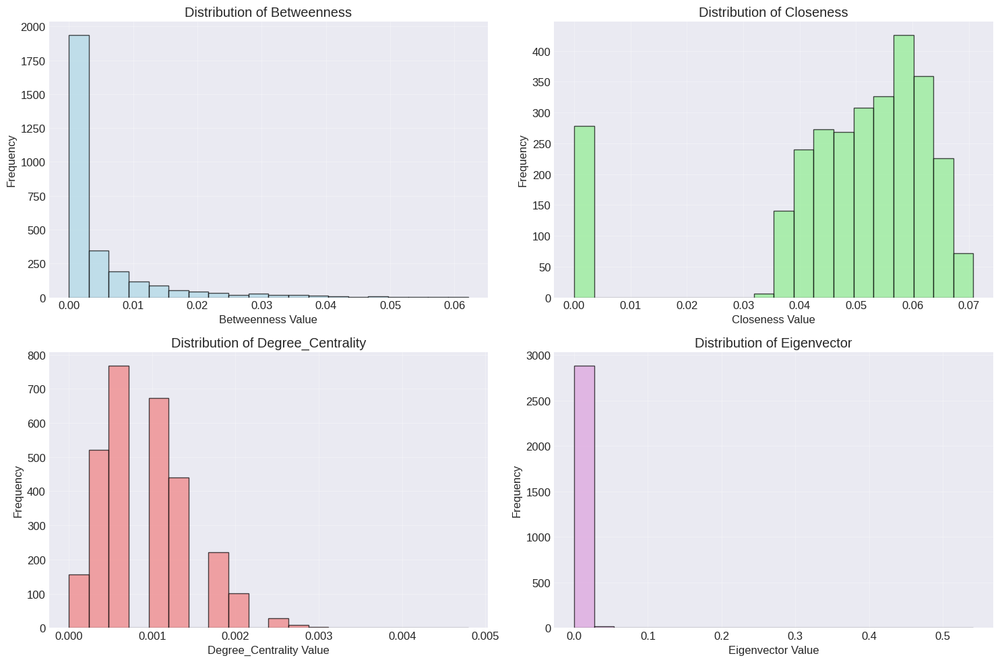


=== TOP NODES BY CENTRALITY ===

Top 5 by Betweenness:
     Node   Residue  Betweenness
A/557/LEU A/557/LEU     0.062104
A/642/LEU A/642/LEU     0.058746
A/700/PHE A/700/PHE     0.057390
C/536/PHE C/536/PHE     0.056454
B/535/GLU B/535/GLU     0.055234

Top 5 by Closeness:
     Node   Residue  Closeness
D/198/VAL D/198/VAL   0.070791
D/118/GLU D/118/GLU   0.070736
A/198/VAL A/198/VAL   0.070711
D/127/TYR D/127/TYR   0.070580
A/194/ARG A/194/ARG   0.070244

Top 5 by Degree_Centrality:
     Node   Residue  Degree_Centrality
C/801/ACO C/801/ACO           0.004791
B/801/ACO B/801/ACO           0.004449
A/801/ACO A/801/ACO           0.004107
D/801/ACO D/801/ACO           0.003422
B/362/TRP B/362/TRP           0.003080

Top 5 by Eigenvector:
     Node   Residue  Eigenvector
C/801/ACO C/801/ACO     0.541452
C/717/GLN C/717/GLN     0.375082
C/714/ASN C/714/ASN     0.263878
C/720/LYS C/720/LYS     0.236342
C/689/MET C/689/MET     0.220756


In [ ]:
# Realizar análisis de centralidad
centralidad_df_S02 = analyze_centrality(G_S02)

**Centrality structure: Rank the top 50 nodes**

In [ ]:
df_full_G_S02, df_top50_G_S02 = analyze_centrality_rankings(G_S02)

Calculating centrality metrics... this may take a moment.
Top 50 saved to 'top_50_centralities.csv'


In [ ]:
df_full_G_S02, df_top50_G_S02 = analyze_centrality_rankings(G_S02)

Calculating centrality metrics... this may take a moment.
Top 50 saved to 'top_50_centralities.csv'


In [ ]:
# Guardar DataFrame como CSV
df_full_G_S02.to_csv('G_S02_full_centrality.csv', index=False)

In [ ]:
# Open CSV as DataFrame
df_full_G_S02 = pd.read_csv('G_S02_full_centrality.csv')

In [ ]:
df_full_G_S02

,Degree_Val,Degree_Rank,Closeness_Val,Closeness_Rank,Betweenness_Val,Betweenness_Rank,Eigenvector_Val,Eigenvector_Rank,Katz_Val,Katz_Rank,PageRank_Val,PageRank_Rank,Subgraph_Val,Subgraph_Rank
A/100/ILE,0.000684,1479.0,0.060506,619.0,0.003645,912.0,7.414770e-08,1064.0,0.017179,1577.0,0.000254,2146.0,2.772552,1596.0
A/101/GLU,0.001369,366.0,0.059221,771.0,0.004422,823.0,6.496317e-08,1107.0,0.021824,395.0,0.000433,719.0,5.330998,475.0
A/102/ALA,0.000684,1479.0,0.059152,779.0,0.000262,1954.0,1.140344e-07,961.0,0.017685,1484.0,0.000227,2327.0,3.060197,1524.0
A/103/ILE,0.001369,366.0,0.063047,359.0,0.010781,396.0,1.481852e-07,896.0,0.021380,474.0,0.000437,700.0,4.979274,572.0
A/104/TYR,0.001027,806.0,0.065658,141.0,0.046480,19.0,1.517281e-07,887.0,0.019702,840.0,0.000321,1597.0,3.845270,1011.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D/95/MET,0.001369,366.0,0.064876,198.0,0.005330,717.0,3.063952e-07,733.0,0.021478,457.0,0.000431,734.0,5.044006,566.0
D/96/LYS,0.002053,43.0,0.061146,554.0,0.006328,631.0,4.692701e-07,656.0,0.023306,213.0,0.000723,44.0,6.500101,284.0
D/97/ARG,0.001027,806.0,0.060017,673.0,0.002569,1076.0,1.330175e-08,1589.0,0.017672,1486.0,0.000406,883.0,3.087245,1509.0
D/98/MET,0.001369,366.0,0.061491,514.0,0.004578,809.0,7.757580e-08,1051.0,0.021102,524.0,0.000430,737.0,5.435238,444.0


In [ ]:
df_full_G_S02F = df_full_G_S02.reset_index().rename(columns={'index': 'Node'})

In [ ]:
# Guardar DataFrame como CSV
df_top50_G_S02.to_csv('G_S02_top50_centrality.csv', index=False)

In [ ]:
# Open CSV as DataFrame
df_top50_G_S02 = pd.read_csv('G_S02_top50_centrality.csv')

In [ ]:
df_top50_G_S02

,Degree,Closeness,Betweenness,Eigenvector,Katz,PageRank,Subgraph
0,C/801/ACO,D/198/VAL,A/557/LEU,C/801/ACO,C/801/ACO,C/801/ACO,C/801/ACO
1,B/801/ACO,D/118/GLU,A/642/LEU,C/717/GLN,B/801/ACO,B/801/ACO,B/801/ACO
2,A/801/ACO,A/198/VAL,A/700/PHE,C/714/ASN,A/801/ACO,A/801/ACO,A/801/ACO
3,D/801/ACO,D/127/TYR,C/536/PHE,C/720/LYS,D/801/ACO,D/801/ACO,C/717/GLN
4,D/362/TRP,A/194/ARG,B/535/GLU,C/689/MET,C/717/GLN,B/362/TRP,D/801/ACO
5,B/362/TRP,B/198/VAL,A/554/LYS,C/687/ARG,D/362/TRP,D/362/TRP,D/362/TRP
6,A/362/TRP,D/133/PRO,D/104/TYR,C/724/HIS,B/362/TRP,A/141/ARG,D/358/PHE
7,D/358/PHE,A/118/GLU,D/554/LYS,C/710/PRO,D/358/PHE,D/695/TRP,B/362/TRP
8,D/695/TRP,C/198/VAL,D/84/PHE,C/690/THR,A/362/TRP,C/396/TRP,A/714/ASN
9,C/717/GLN,D/194/ARG,C/535/GLU,C/713/ASP,A/91/GLN,C/695/TRP,A/362/TRP


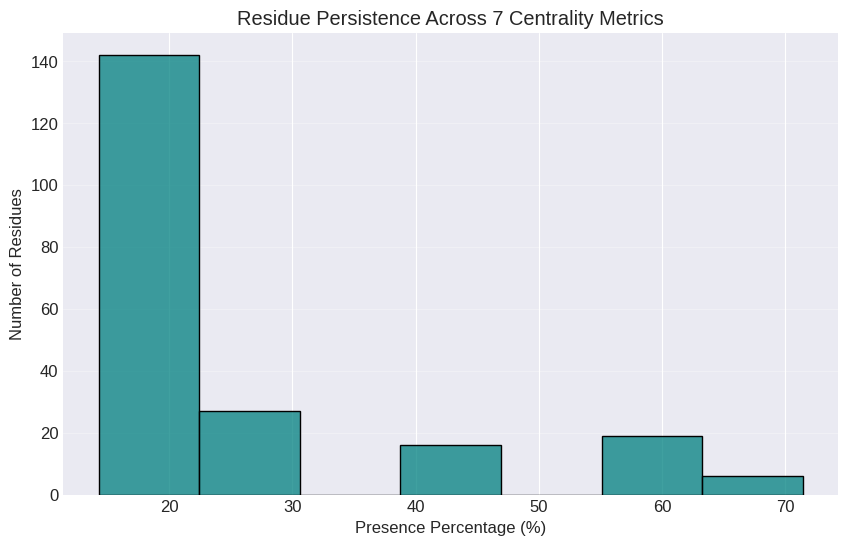

In [ ]:
df_persistencedf_top50_G_S02 = analyze_top_residues_consensus(df_top50_G_S02)

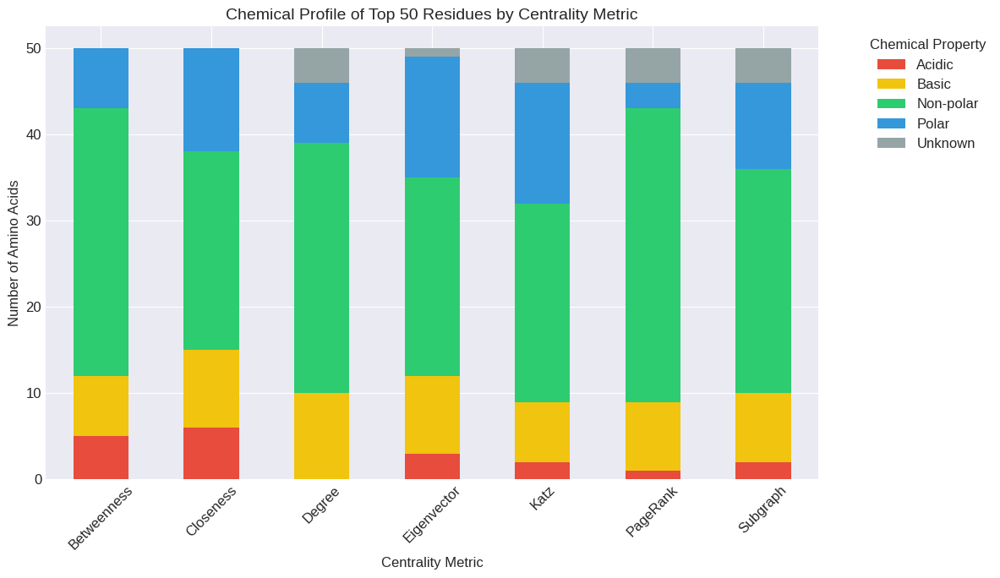

In [ ]:
df_chemical_count_G_S02 = plot_physicochemical_centrality_comparison(df_top50_G_S02)

/tmp/ipython-input-2046957629.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


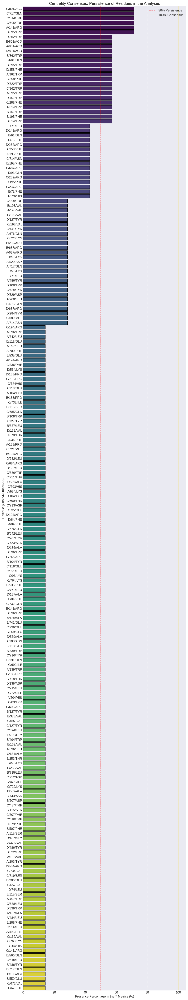

In [ ]:
df_key_residues_G_S02 = generate_complete_persistence_analysis(df_top50_G_S02)

In [ ]:
#visualize_persistence_3d_clean(df_key_residues_G_S01, pdb_path='./6EDW-R.pdb')
visualize_persistence_3d_clean(df_key_residues_G_S02, pdb_path='../structures/6EDZ-R.pdb')

✅ Visualizing ./6EDZ-R.pdb. Labels only shown for the 10 most persistent residues.


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
visualize_3d_persistence_pro(df_key_residues_G_S02, pdb_path='../structures/6EDZ-R.pdb', show_labels=False)

🔹 Showing ./6EDZ-R.pdb without labels (clean view)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
nearby_residues_ACO801 = find_nearby_amino_acids('../structures/6EDZ-R.pdb', target_residue="ACO", residue_number=801, distance=4.0)
df_nearby_ACO801 = pd.DataFrame(nearby_residues_ACO801)
df_nearby_ACO801

""


#### d) Null models

Null models: generate ten Erdős–Rényi (ER) and ten Barabási–Albert (BA) networks with the same number of nodes and edges as your real network.

In [ ]:
df_nulls_G_S02 = null_models_analysis(G_S02)
df_nulls_G_S02

,Metric,Real,ER_Mean,ER_Std,BA_Mean,BA_Std
Alpha,Alpha,2.546191,2.493918,1.662467e-02,2.660413,2.235570e-01
Avg_Betweenness,Avg_Betweenness,0.004628,0.001967,3.869978e-05,0.002474,2.204029e-04
Avg_Closeness,Avg_Closeness,0.048118,0.107430,5.936414e-04,0.126928,9.900578e-03
Avg_Eigenvector,Avg_Eigenvector,0.001719,0.011680,4.844138e-04,0.004279,5.572465e-04
Avg_PageRank,Avg_PageRank,0.000342,0.000342,4.040583e-20,0.000342,6.515244e-20


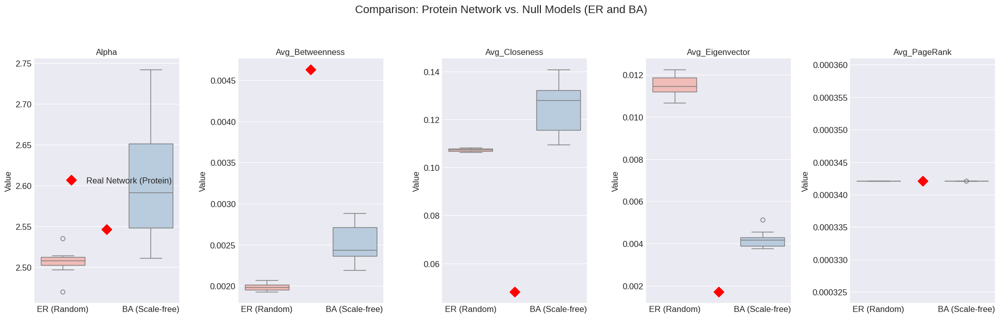

In [ ]:
plot_null_model_comparison(G_S02)

#### f) Community analysis

**Infomap Community analysis**

/tmp/ipython-input-3546655207.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', 10)


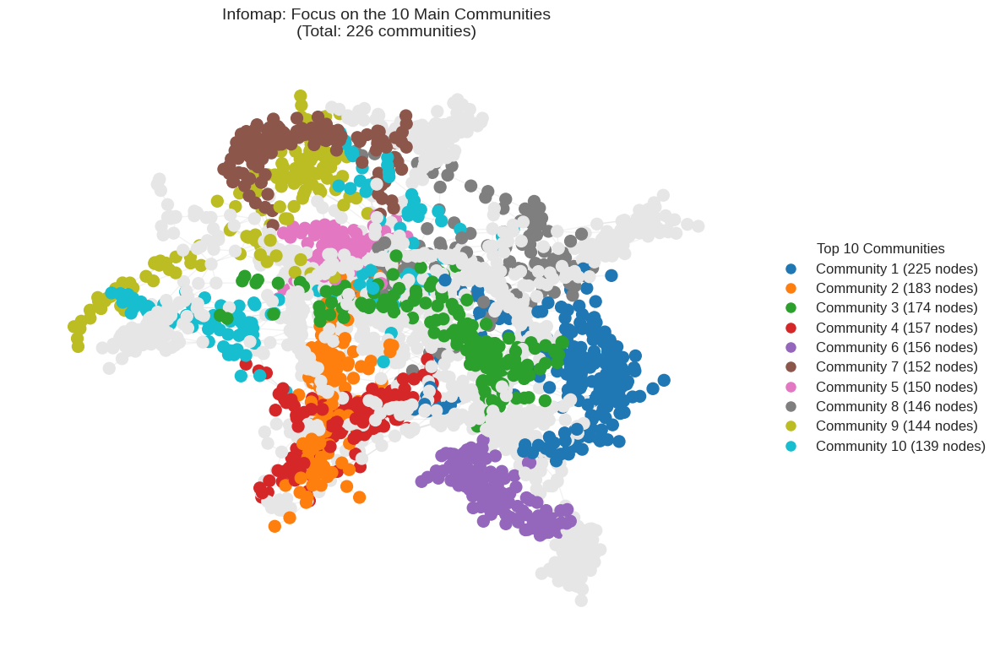

In [ ]:
result_S02 = analyze_and_visualize_infomap(G_S02)

**Comparative Community analysis**

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', 10)


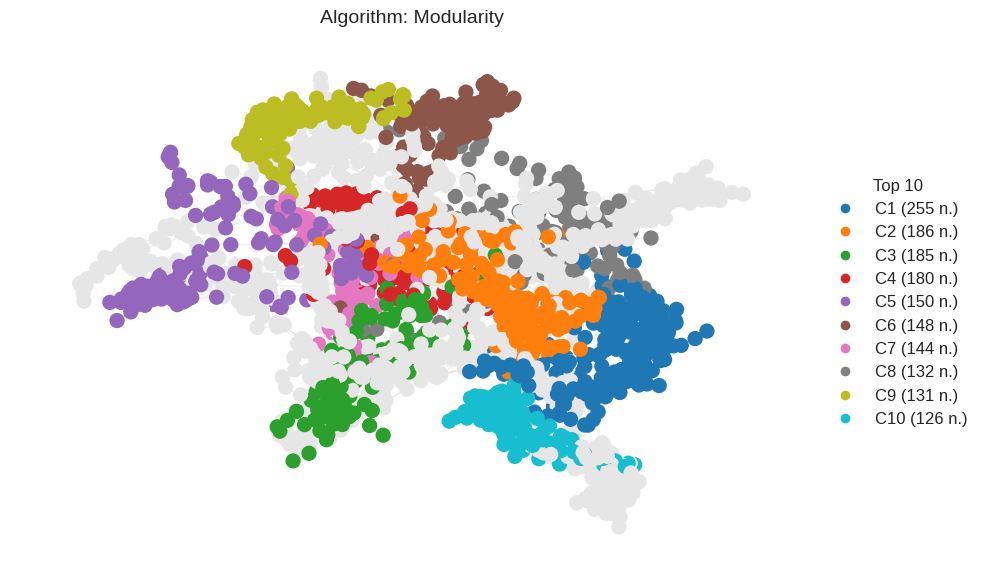

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', 10)


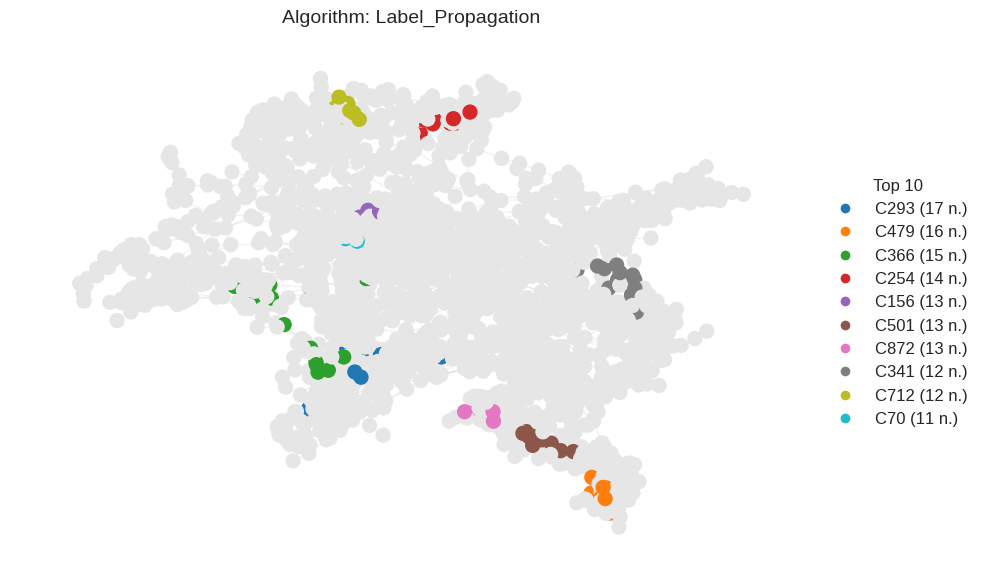

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', 10)


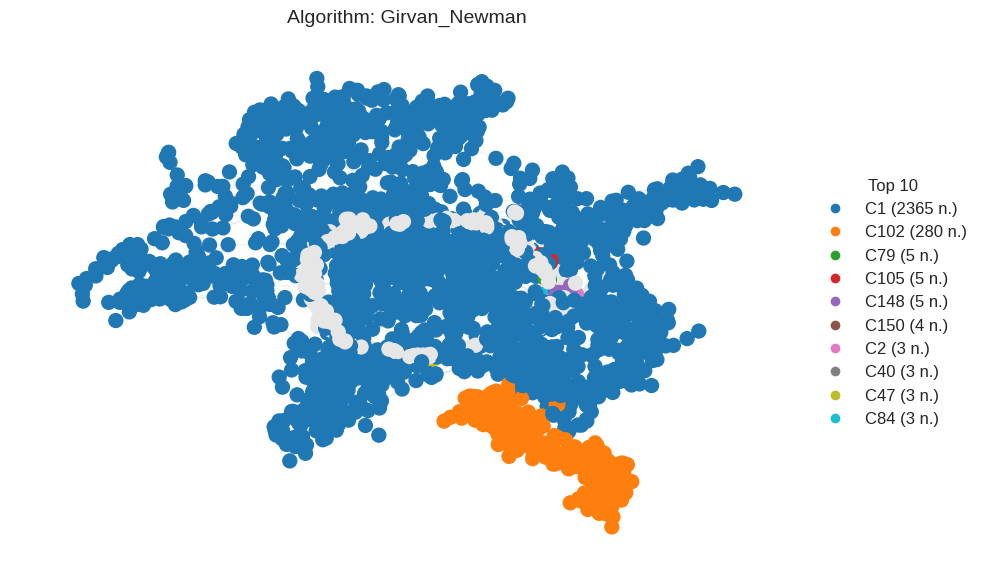

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', 10)


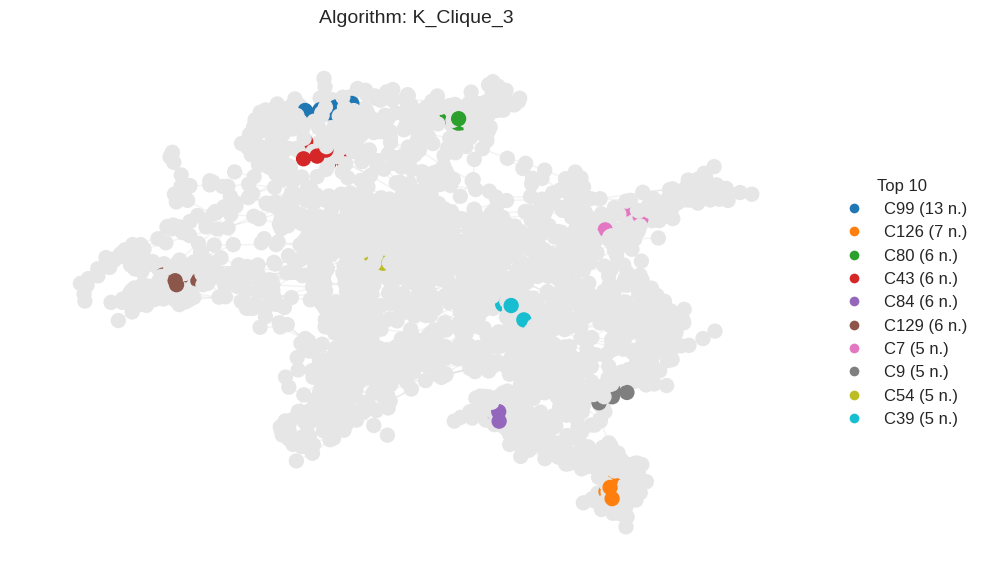

✅ Analysis complete. File saved as: G_S02_mi_analisis_completo.csv


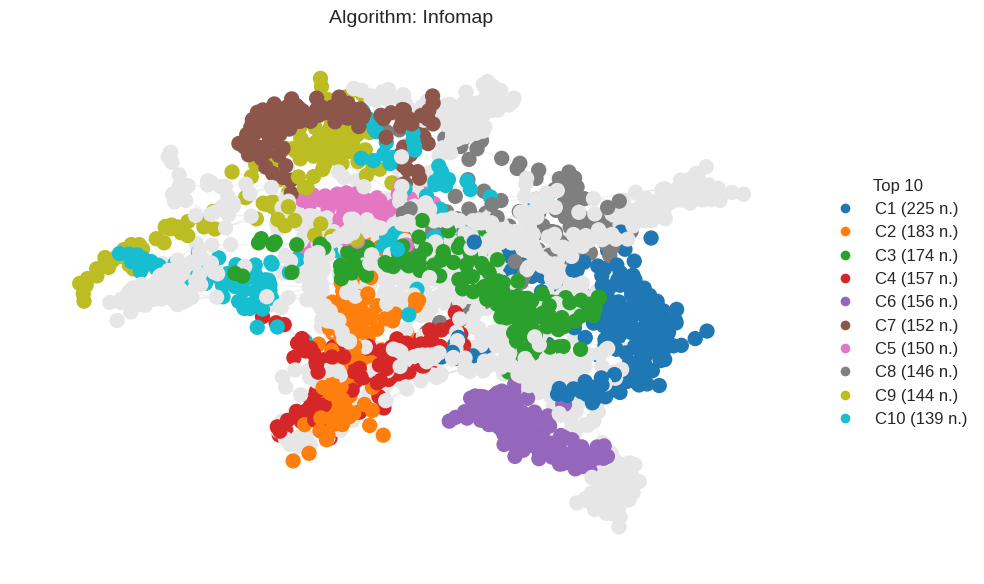

In [ ]:
df_resultados_Community_analysis_G_S02 = comparative_community_analysis(G_S02, "G_S02_mi_analisis_completo.csv")

In [ ]:
# Reading the generated Community Data
nombre_archivo_G_S02 = "G_S02_mi_analisis_completo.csv"
df_community_analisis_G_S02 = pd.read_csv(nombre_archivo_G_S02)
df_community_analisis_G_S02

,Node,Infomap,Modularity,Label_Propagation,Girvan_Newman,K_Clique_3
0,A/100/ILE,2,7,1,1,0
1,A/101/GLU,5,14,2,1,0
2,A/102/ALA,5,14,3,1,0
3,A/103/ILE,5,14,4,1,0
4,A/104/TYR,5,7,5,1,0
...,...,...,...,...,...,...
2918,D/95/MET,17,1,728,1,0
2919,D/96/LYS,17,1,728,1,0
2920,D/97/ARG,17,19,755,1,0
2921,D/98/MET,17,1,445,1,165


In [ ]:
# Definir los métodos que estás analizando
metodos = ['Infomap', 'Modularity', 'Label_Propagation', 'Girvan_Newman', 'K_Clique_3']

# Count community sizes by method and graph them
plt.figure(figsize=(10, 5))
for metodo in metodos:
    counts_G_S02 = df_community_analisis_G_S02[metodo].value_counts().values
    sns.kdeplot(counts_G_S02, label=metodo, fill=True, alpha=0.3)

plt.xlabel("Community Size (Number of Nodes)")
plt.ylabel("Density")
plt.title("Community Size Distribution")
plt.legend()
plt.show()

**Consensus analysis between community analysis algorithms**

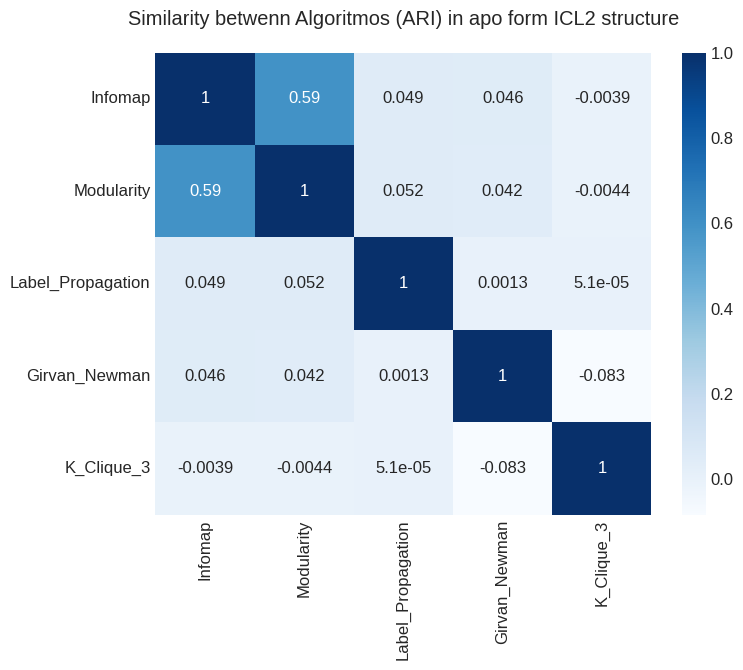

In [ ]:
from sklearn.metrics import adjusted_rand_score
import seaborn as sns

# Calculate similarity matrix between columns
metodos = df_community_analisis_G_S02.columns[1:] # Excluimos la columna 'Nodo'
ari_matrix_G_S02 = pd.DataFrame(index=metodos, columns=metodos)

for m1 in metodos:
    for m2 in metodos:
        ari_matrix_G_S02.loc[m1, m2] = adjusted_rand_score(df_community_analisis_G_S02[m1], df_community_analisis_G_S02[m2])

plt.figure(figsize=(8, 6))
sns.heatmap(ari_matrix_G_S02.astype(float), annot=True, cmap='Blues')
plt.title("Similarity betwenn Algoritmos (ARI) in apo form ICL2 structure",
          pad=20)
plt.show()

In [ ]:
visualize_local_pdb_communities(df_community_analisis_G_S02, 'Infomap', '../structures/6EDZ-R.pdb', n_communities=4)

📊 Coloring the 4 largest communities for method: Infomap
   - Community 1: #1f77b4 (225 residues)
   - Community 2: #ff7f0e (183 residues)
   - Community 3: #2ca02c (174 residues)
   - Community 4: #d62728 (157 residues)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
visualize_local_pdb_communities(df_community_analisis_G_S02, 'Girvan_Newman', '../structures/6EDZ-R.pdb', n_communities=4)

📊 Coloring the 4 largest communities for method: Girvan_Newman
   - Community 1: #1f77b4 (2365 residues)
   - Community 102: #ff7f0e (280 residues)
   - Community 105: #2ca02c (5 residues)
   - Community 79: #d62728 (5 residues)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

**Which nodes are most related?**

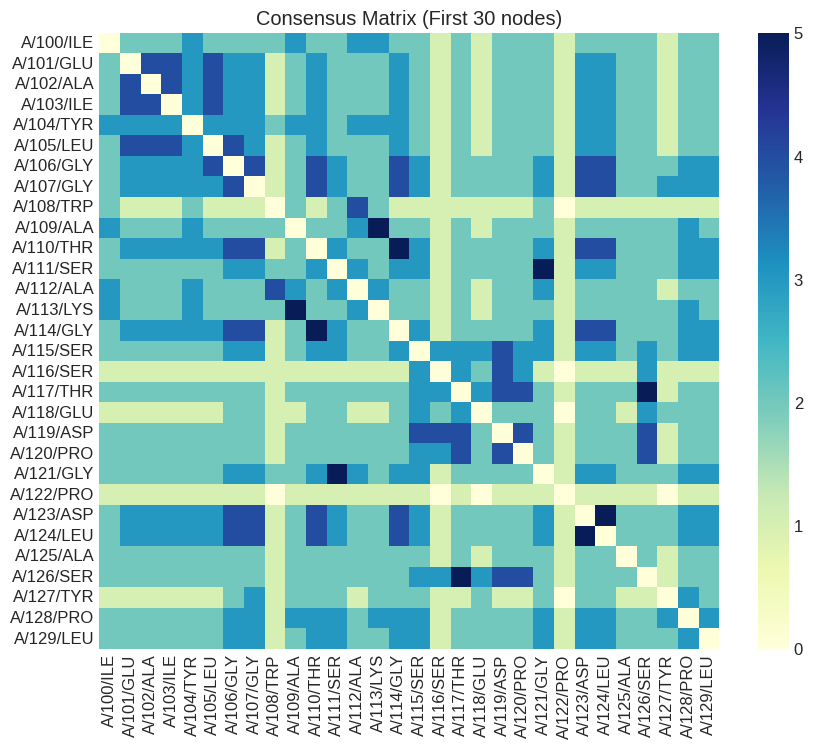

In [ ]:
nodos = df_community_analisis_G_S02['Node'].values
n = len(nodos)
co_occurrence = np.zeros((n, n))

# Iterate through each pair of nodes
for i in range(n):
    for j in range(i + 1, n):
        # Count how many columns have the same values ​​in row i and j
        matches = (df_community_analisis_G_S02.iloc[i, 1:] == df_community_analisis_G_S02.iloc[j, 1:]).sum()
        co_occurrence[i, j] = co_occurrence[j, i] = matches

# Visualize a sample or the nodes with the highest relationship
plt.figure(figsize=(10, 8))
sns.heatmap(co_occurrence[:30, :30], xticklabels=nodos[:30], yticklabels=nodos[:30], cmap="YlGnBu")
plt.title("Consensus Matrix (First 30 nodes)")
plt.show()

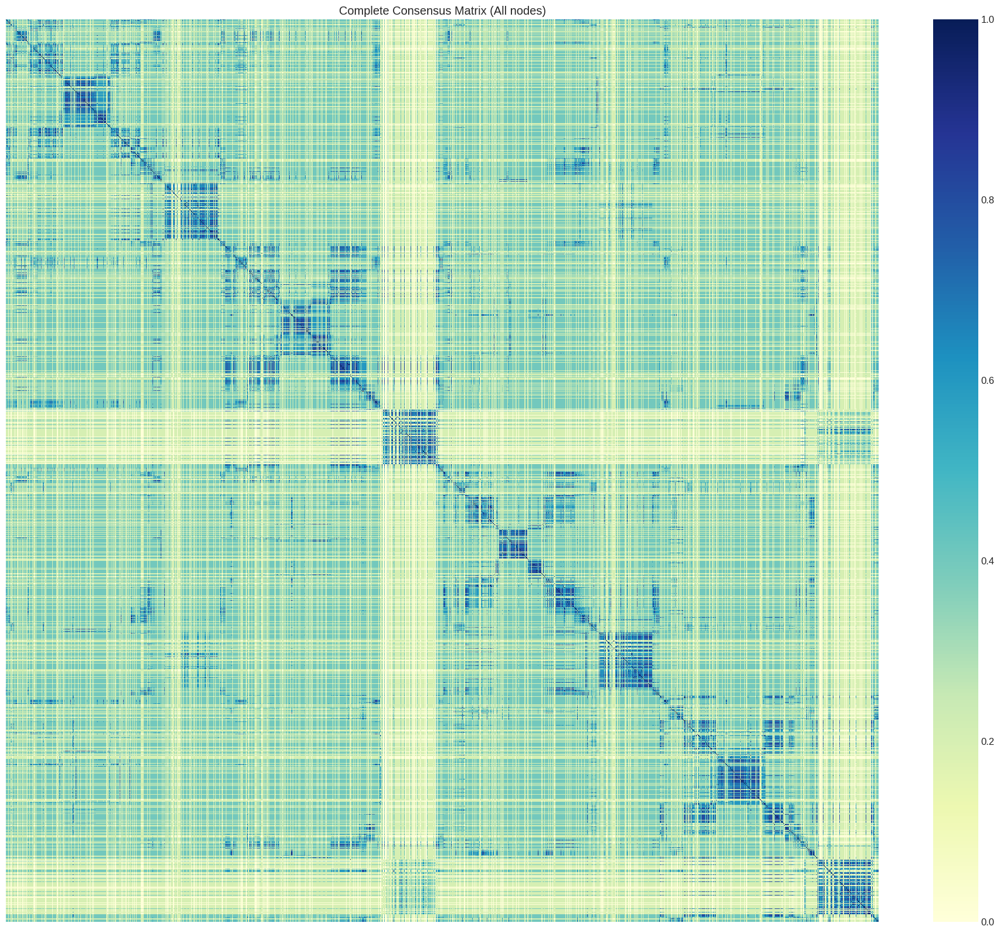

In [ ]:
# Consensus Matrix
matriz_total_G_S02 = generate_consensus_matrix(df_community_analisis_G_S02)

# Visualización (si n_nodos es manejable, ej. < 200)
plt.figure(figsize=(24, 20))
sns.heatmap(matriz_total_G_S02, cmap="YlGnBu", xticklabels=False, yticklabels=False)
plt.title("Complete Consensus Matrix (All nodes)")
plt.savefig("G_S02_Consensus Matrix.png", dpi=300, bbox_inches='tight')
plt.savefig("G_S02_Consensus Matrix.pdf", bbox_inches='tight')
plt.savefig("G_S02_Consensus Matrix.svg", bbox_inches='tight')
plt.show()

**Generate Consensus graph**

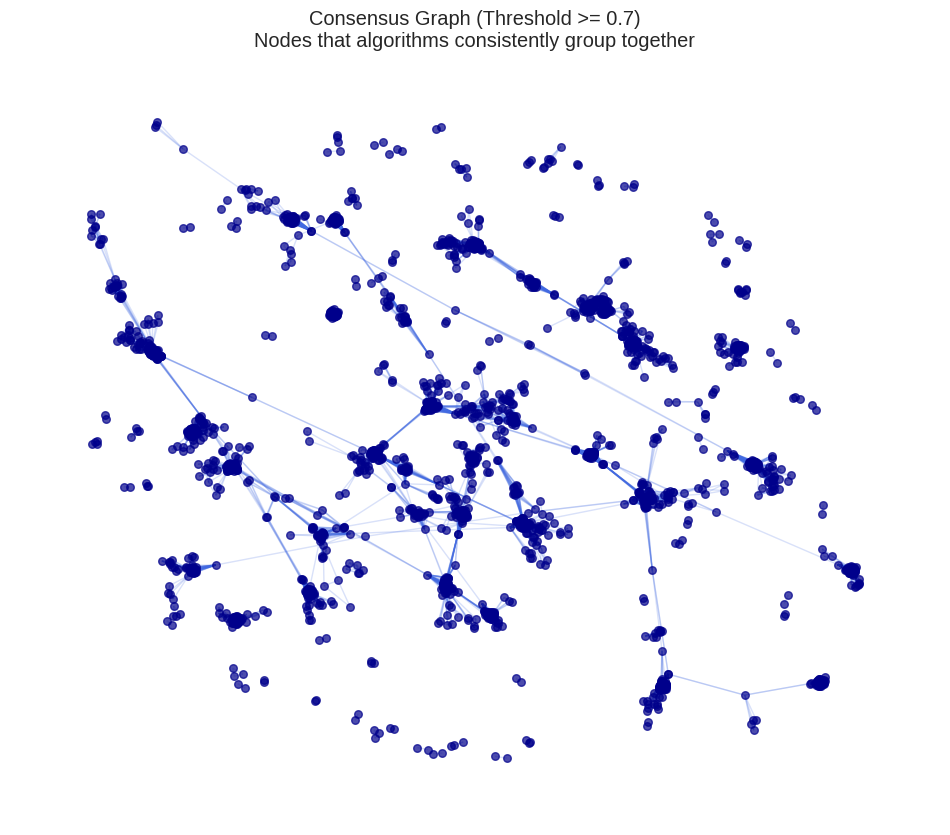

Identified 69759 reliable relationships.


In [ ]:
df_gold_relationships_G_S02, network_gold_relationships_G_S02 = extract_consensus_and_plot(df_community_analisis_G_S02, threshold=0.7)

**Umbral analysis in concensus graph**

In [ ]:
df_gold_relationships_G_S02

,Node_A,Node_B,Consensus_Strength
0,A/100/ILE,A/169/ASP,0.8
1,A/100/ILE,A/171/ARG,0.8
2,A/100/ILE,A/521/ILE,0.8
3,A/100/ILE,A/522/THR,0.8
4,A/100/ILE,A/524/GLY,0.8
...,...,...,...
69754,D/94/SER,D/96/LYS,0.8
69755,D/94/SER,D/99/GLY,0.8
69756,D/95/MET,D/96/LYS,1.0
69757,D/95/MET,D/99/GLY,1.0


In [ ]:
df_multi_threshold_G_S02 = generate_multi_threshold_consensus_csv(df_community_analisis_G_S02, thresholds=[1.0, 0.9, 0.8, 0.7, 0.6])

Multi-threshold consensus file generated: multi_threshold_consensus.csv


In [ ]:
df_multi_threshold_G_S02

,Node,threshold_1.0,threshold_0.9,threshold_0.8,threshold_0.7,threshold_0.6
0,A/100/ILE,1,1,1,1,1
1,A/101/GLU,2,2,1,1,1
2,A/102/ALA,3,3,1,1,1
3,A/103/ILE,4,4,1,1,1
4,A/104/TYR,5,5,1,1,1
...,...,...,...,...,...,...
2918,D/95/MET,983,983,1,1,1
2919,D/96/LYS,983,983,1,1,1
2920,D/97/ARG,1021,1021,1,1,1
2921,D/98/MET,592,592,1,1,1


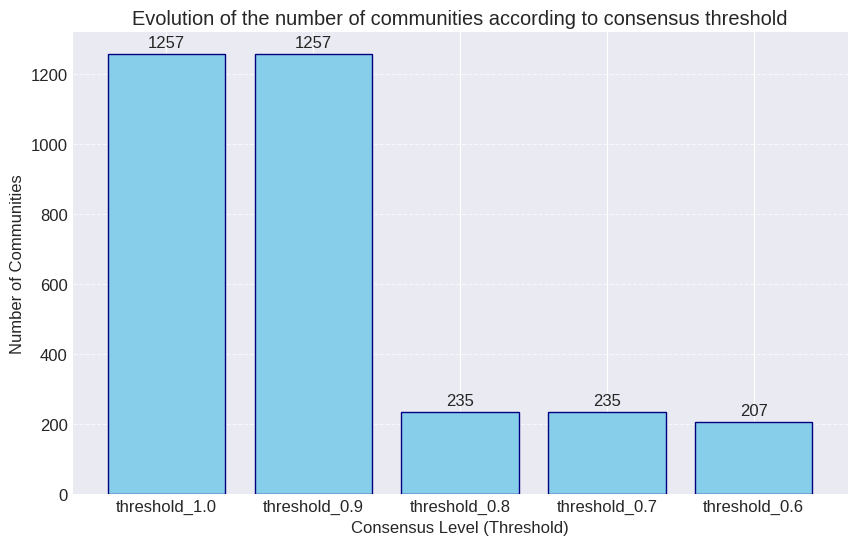

In [ ]:
plot_unit_count(df_multi_threshold_G_S02)

In [ ]:
#Execute Sankey passing that specific dataframe
generate_filtered_sankey(df_multi_threshold_G_S02, min_nodes=5)

In [ ]:
# (Opcional) Establecer el nodo como el índice para realizar búsquedas rápidas
# df_analisis.set_index('Nodo', inplace=True)

# 3. Mostrar las primeras filas y un resumen rápido
print("Vista previa del análisis comparativo:")
print(df_community_analisis_G_S02.head())

print("\nConteo de comunidades por cada método:")
print(df_community_analisis_G_S02.nunique())

Vista previa del análisis comparativo:
        Node  Infomap  Modularity  Label_Propagation  Girvan_Newman  \
0  A/100/ILE        2           7                  1              1   
1  A/101/GLU        5          14                  2              1   
2  A/102/ALA        5          14                  3              1   
3  A/103/ILE        5          14                  4              1   
4  A/104/TYR        5           7                  5              1   

   K_Clique_3  
0           0  
1           0  
2           0  
3           0  
4           0  

Conteo de comunidades por cada método:
Node                 2923
Infomap               226
Modularity            231
Label_Propagation     915
Girvan_Newman         208
K_Clique_3            173
dtype: int64


 #### e) Structural analysis


=== ANALYSIS OF INTERACTION TYPES ===
Types of interaction found (columna: interaction):
interaction
VDW          2656
HBOND        2639
PIPISTACK     148
IONIC          95
PICATION       45
PIHBOND         4
Name: count, dtype: int64


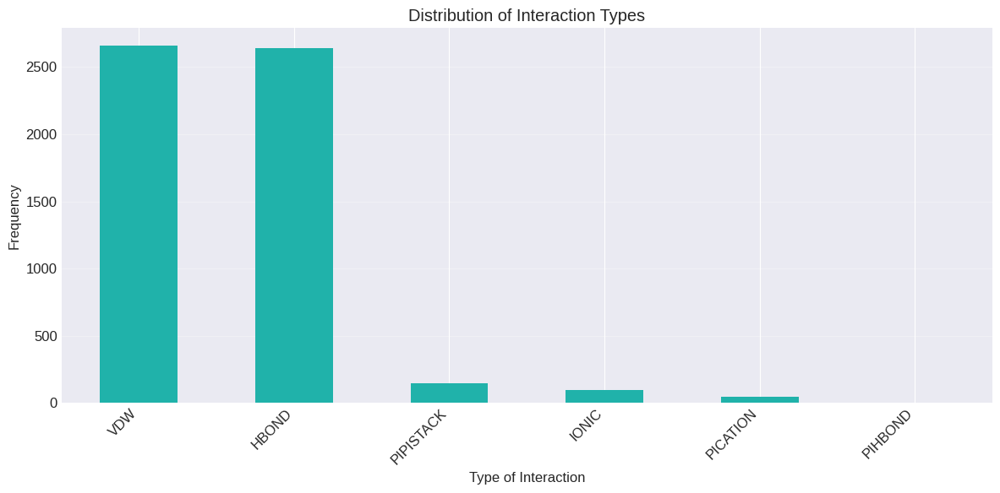

In [ ]:
# Analizar tipos de interacción
distribucion_interacciones_S02 = analizar_tipos_interaccion(df_edges_S02, G_S02)

In [ ]:
df_Structural_properties_G_S02 = analyze_allosteric_properties('../structures/6EDZ-R.pdb')

In [ ]:
df_Structural_properties_G_S02

,id,SASA,B-Factor,Hydrophobicity,Packing_Density
0,A/12/THR,69.73,82.86,-0.7,4
1,A/13/PRO,92.87,81.28,-1.6,6
2,A/14/PHE,53.46,71.81,2.8,6
3,A/15/GLU,84.84,84.04,-3.5,7
4,A/16/GLN,137.00,83.36,-3.5,8
...,...,...,...,...,...
2918,D/762/ILE,0.00,65.61,4.5,7
2919,D/763/THR,23.98,68.27,-0.7,8
2920,D/764/LYS,84.96,73.91,-3.9,7
2921,D/765/GLU,161.12,73.92,-3.5,4


📊 Spearman Correlation: -0.322 (p-value: 1.989e-71)

🚀 Candidates for Rigid Allosteric Centers (High Betweenness / Low B-Factor):
           Node  Betweenness_Val  B-Factor
489   A/557/LEU         0.062104     54.75
573   A/642/LEU         0.058746     56.16
637   A/700/PHE         0.057390     51.25
1921  C/536/PHE         0.056454     54.94
1197  B/535/GLU         0.055234     61.46


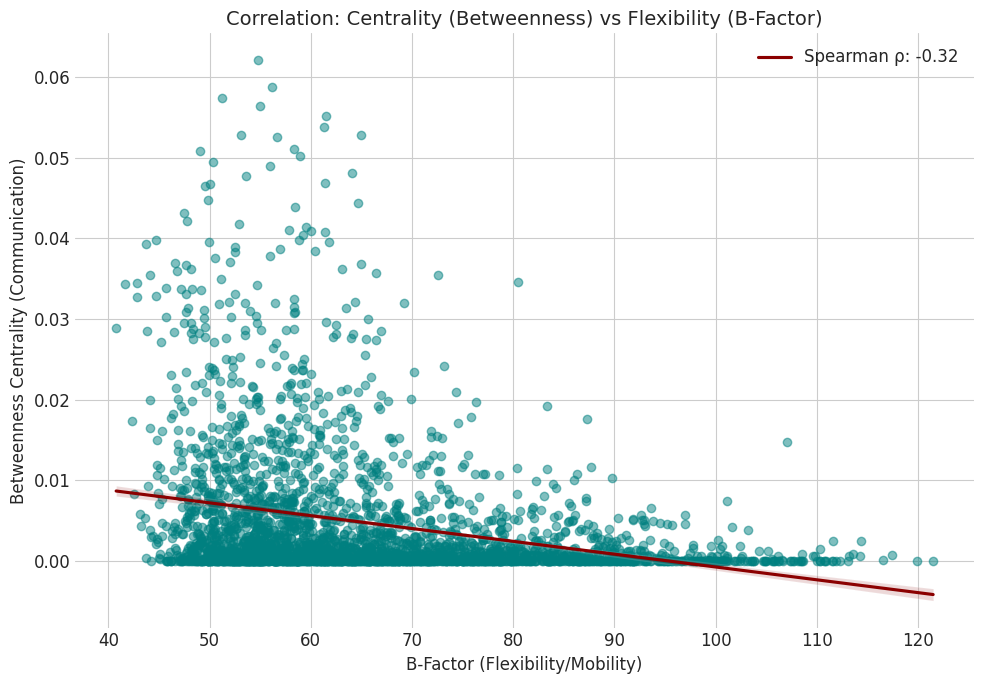

In [ ]:
df_Betweeness_B_factor_G_S02 = plot_network_structure_correlation(df_full_G_S02F, df_Structural_properties_G_S02)

__Percolation analysis__

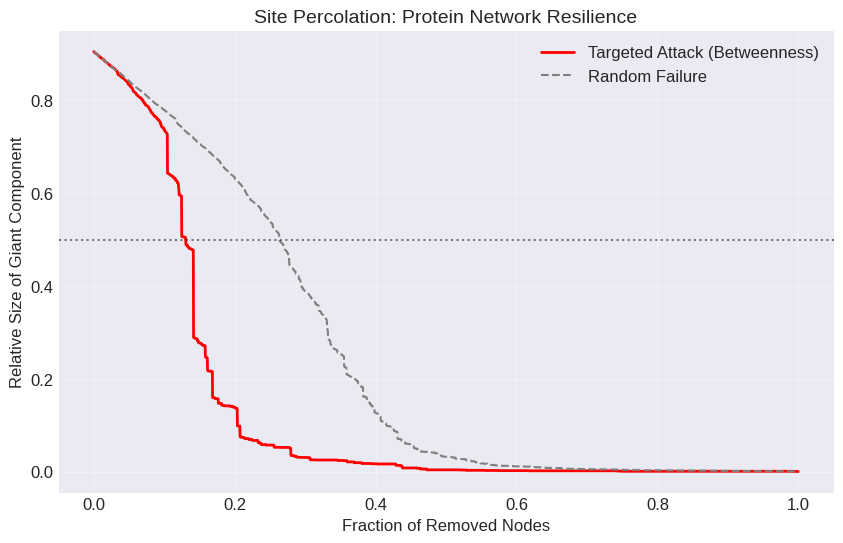

In [ ]:
df_percolacion_G_S02 = site_percolation_analysis(G_S02)